In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mlt
from IPython.display import display

plt.style.use("fivethirtyeight")
plt.rcParams["figure.figsize"]=(20,5)
plt.rcParams["figure.dpi"]=100
plt.rcParams["lines.linewidth"]=2

In [2]:
df=pd.read_pickle("../data/interim/01_Data_Processed.pkl")
df

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,40
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,40
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,40


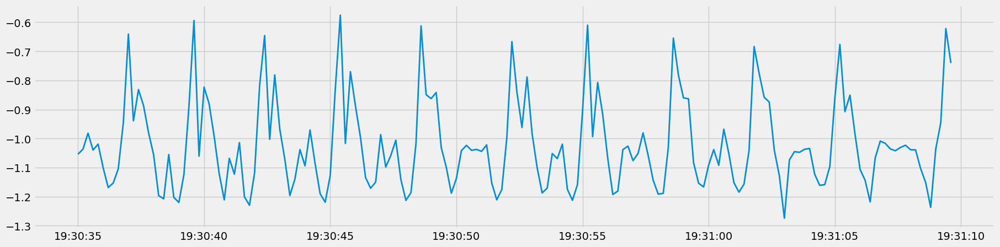

In [3]:
set_df=df[df["Set"]==1]
plt.plot(set_df["Accelerometer_y"])

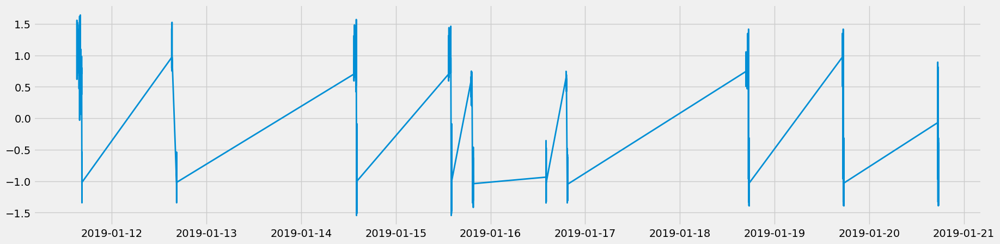

In [4]:
plt.plot(df["Accelerometer_y"])

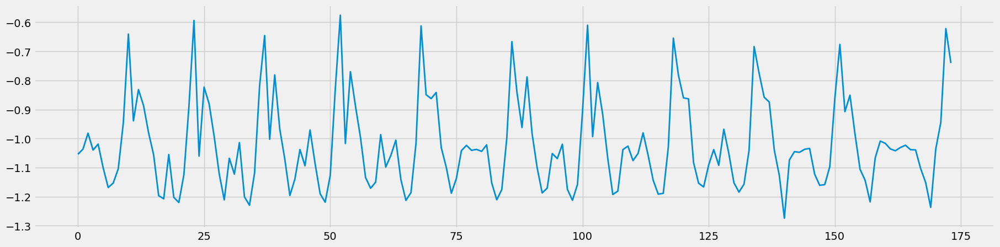

In [5]:
plt.plot(set_df["Accelerometer_y"].reset_index(drop=True))

In [6]:
df_label_unique=df["Label"].unique()
df_label_unique

array(['bench', 'ohp', 'squat', 'dead', 'row', 'rest'], dtype=object)

In [1]:
for label in df_label_unique:
    subset = df[df["Label"]==label]
    plt.plot(subset["Accelerometer_y"].reset_index(drop=True),label=label)
    plt.show()

NameError: name 'df_label_unique' is not defined

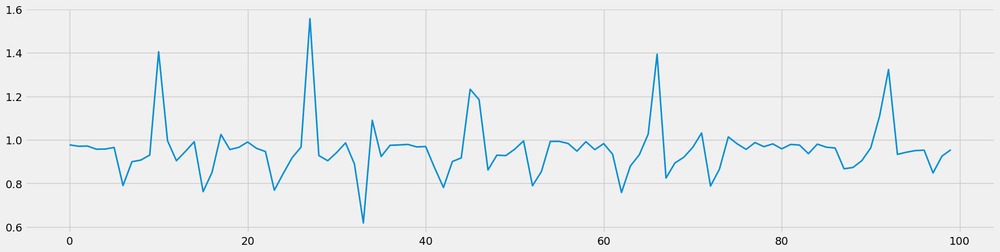

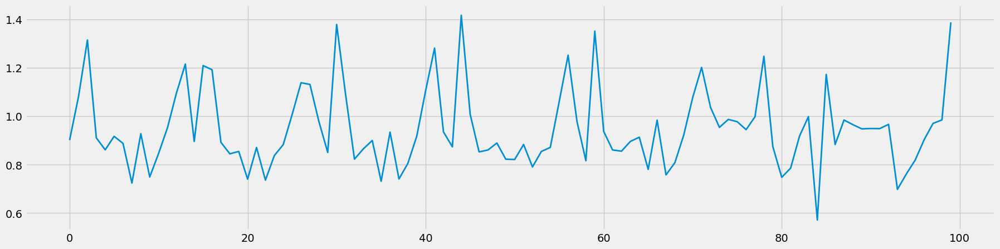

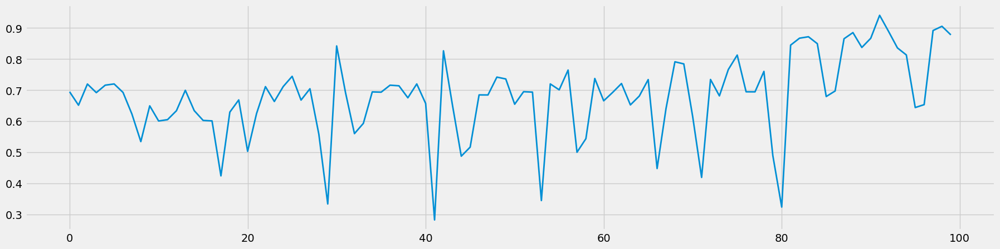

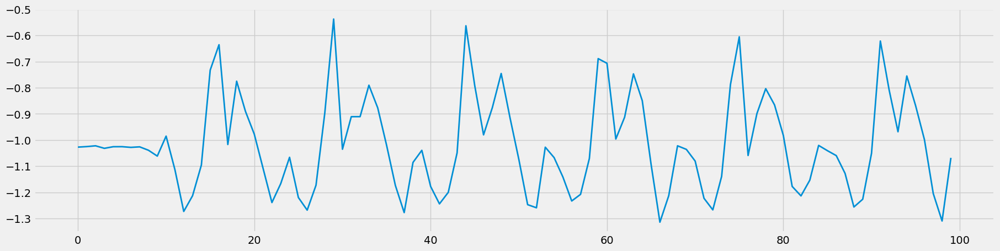

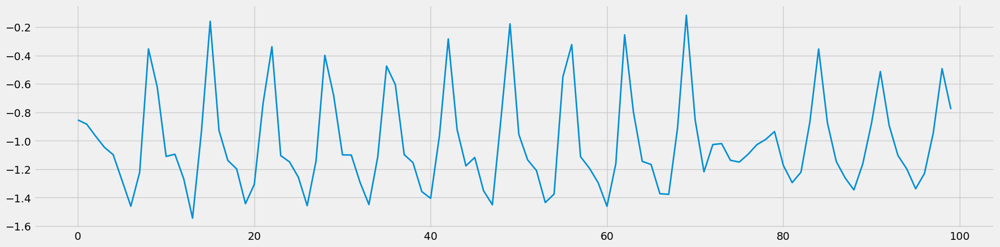

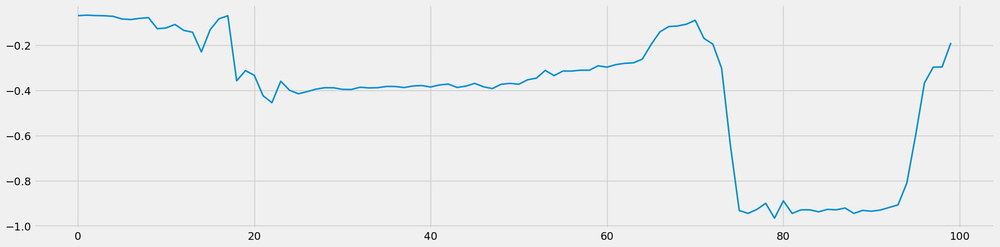

In [8]:
for label in df_label_unique:
    subset = df[df["Label"]==label]
    plt.plot(subset[:100]["Accelerometer_y"].reset_index(drop=True),label=label)
    plt.show()

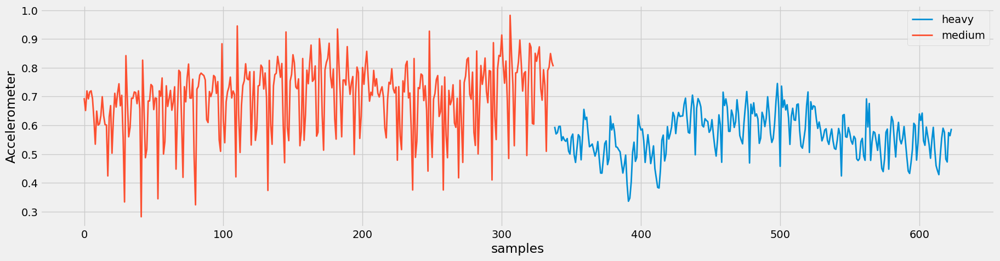

In [9]:
catogory_df=df.query("Label=='squat'").query("Participants=='A'").reset_index()

fig,ax=plt.subplots()
catogory_df.groupby(["Category"])["Accelerometer_y"].plot()
ax.set_ylabel("Accelerometer")
ax.set_xlabel("samples")
plt.legend()


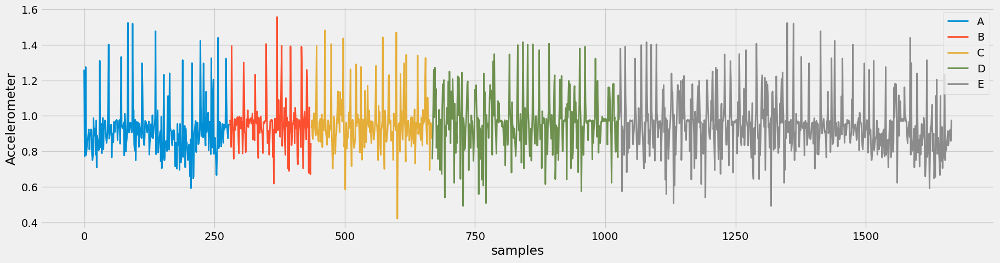

In [10]:
Participants_df=df.query("Label=='bench'").sort_values("Participants").reset_index()

fig,ax=plt.subplots()
Participants_df.groupby(["Participants"])["Accelerometer_y"].plot()
ax.set_ylabel("Accelerometer")
ax.set_xlabel("samples")
plt.legend()


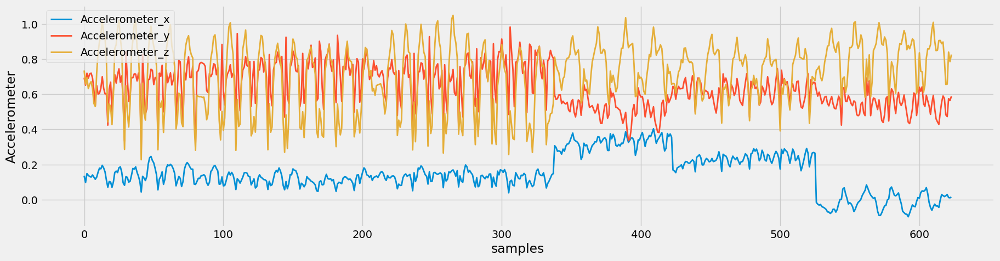

In [11]:
label="squat"
participants="A"
all_axis_df=df.query(f"Label=='{label}'").query(f"Participants=='{participants}'").reset_index()

fig,ax=plt.subplots()
all_axis_df[["Accelerometer_x","Accelerometer_y","Accelerometer_z"]].plot(ax=ax)
ax.set_ylabel("Accelerometer")
ax.set_xlabel("samples")
plt.legend()

/tmp/ipykernel_4713/2291693333.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax=plt.subplots()


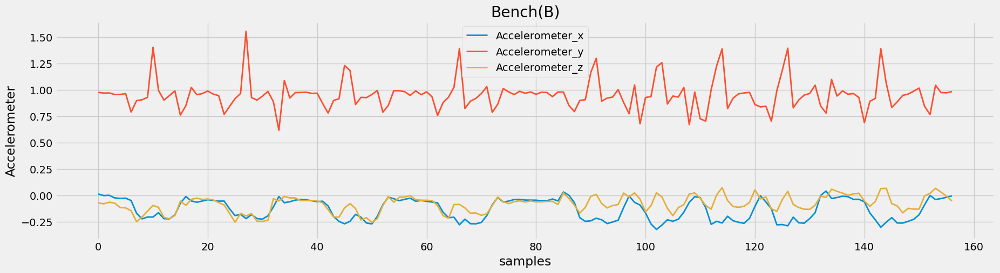

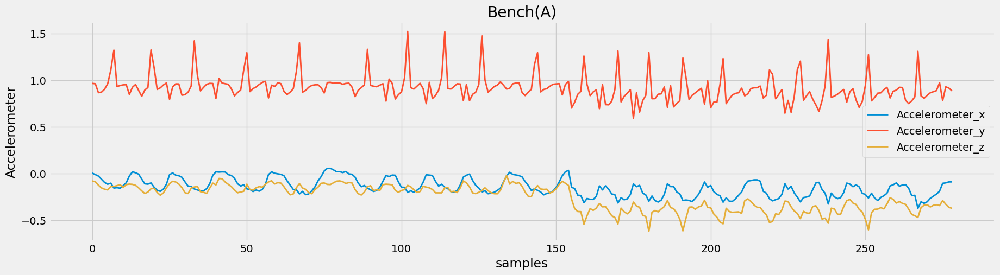

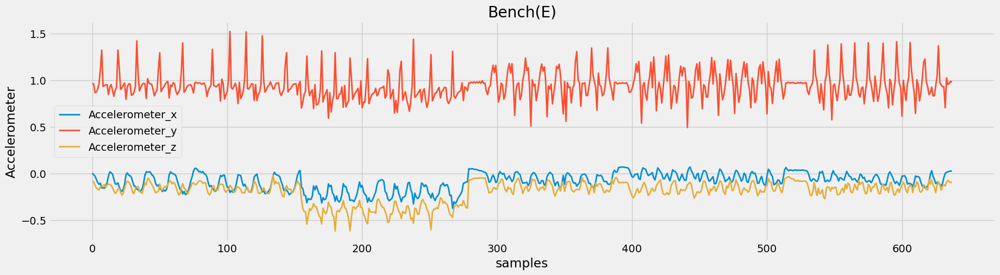

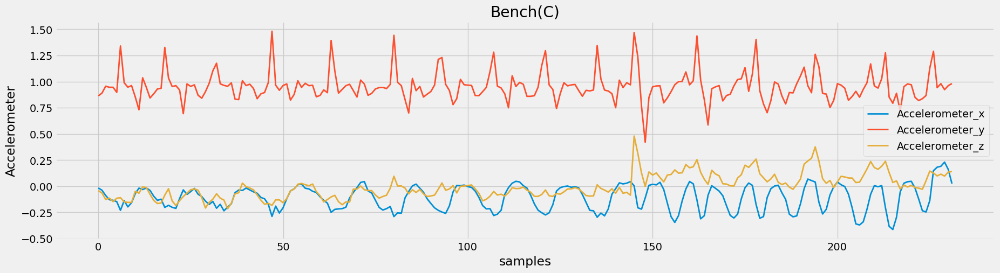

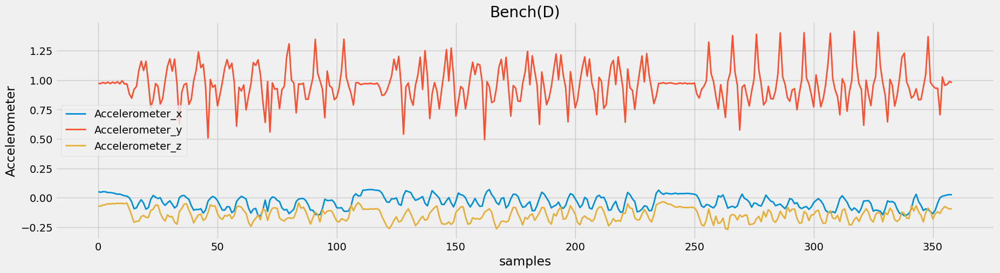

...

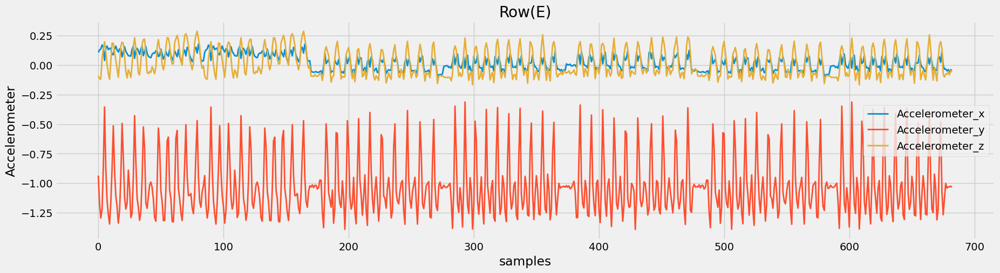

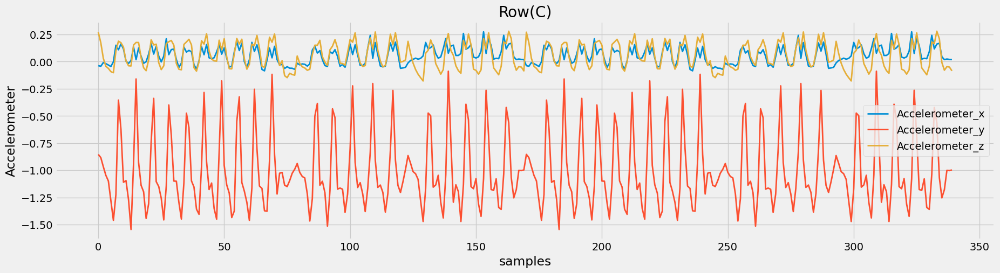

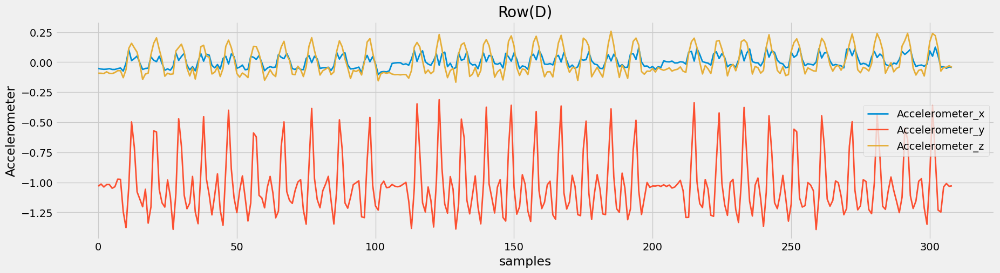

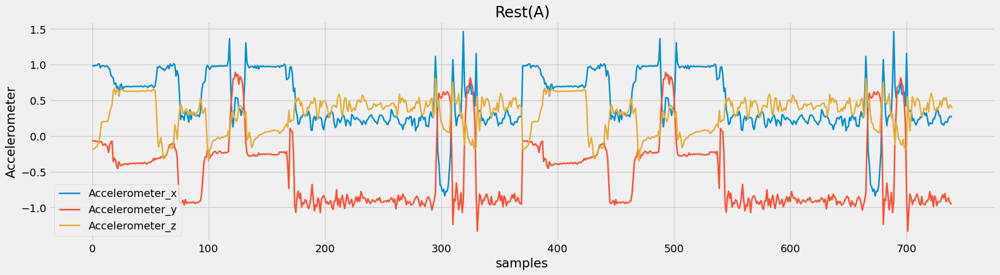

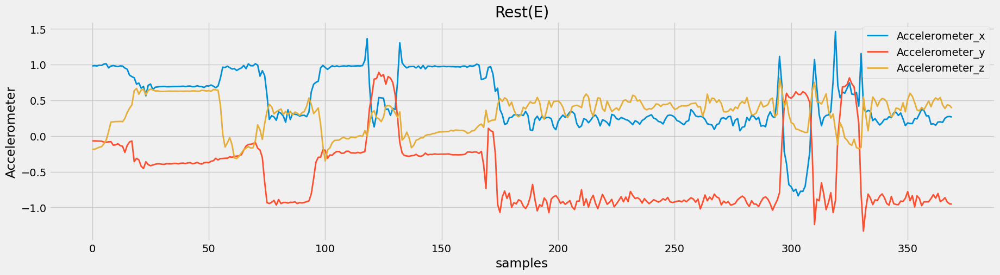

In [12]:
labels=df["Label"].unique()
participants=df["Participants"].unique()

for label in labels:
    for participant in participants:
        all_axis_df=df.query(f"Label=='{label}'").query(f"Participants=='{participant}'").reset_index()


        if len(all_axis_df)!=0:
            fig,ax=plt.subplots()
            all_axis_df[["Accelerometer_x","Accelerometer_y","Accelerometer_z"]].plot(ax=ax)
            ax.set_ylabel("Accelerometer")
            ax.set_xlabel("samples")
            plt.title(f"{label}({participant})".title())
            plt.legend()

/tmp/ipykernel_4713/3244391225.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax=plt.subplots()


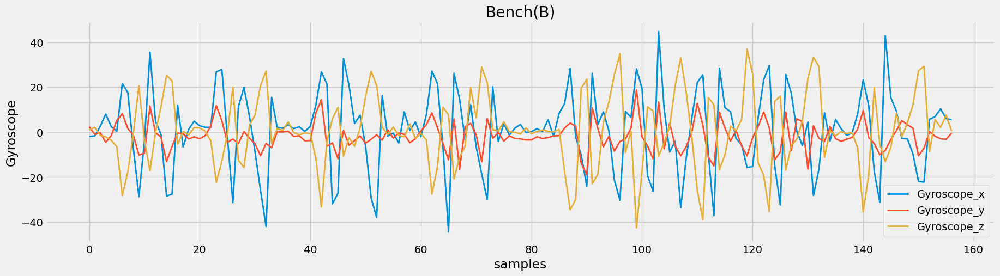

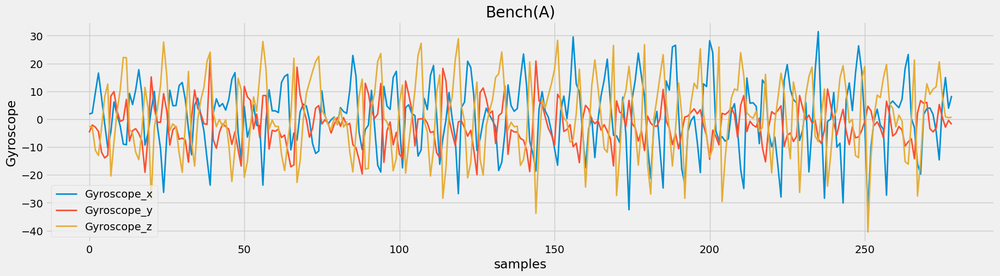

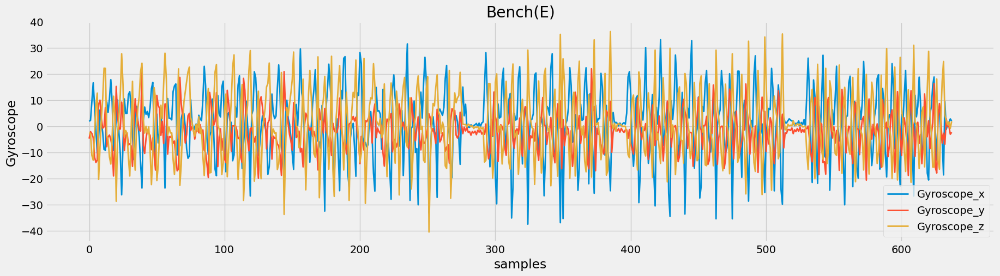

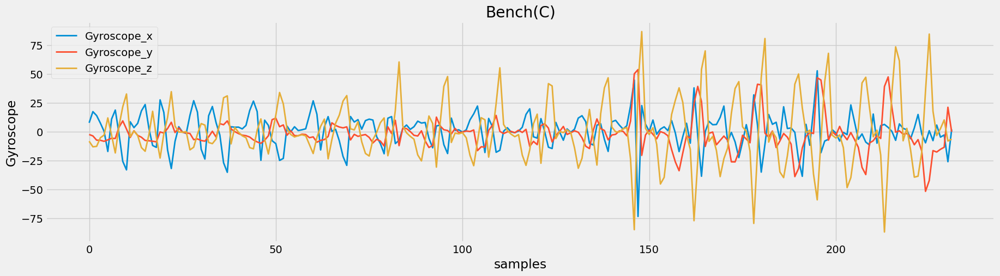

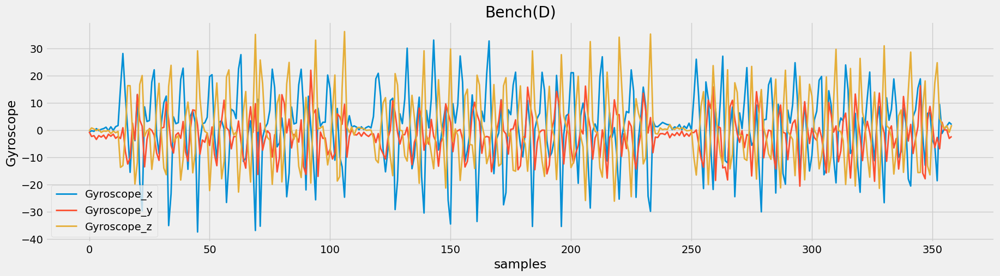

...

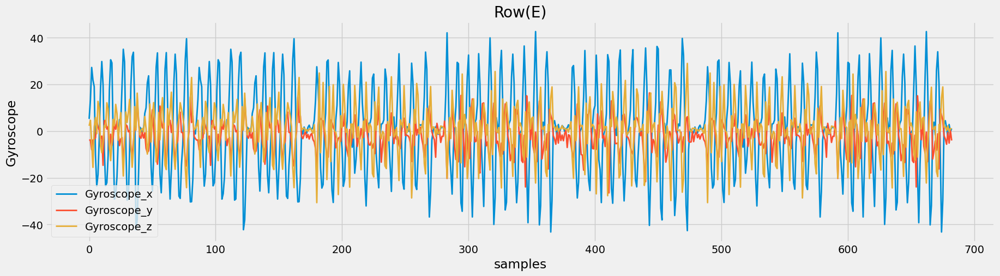

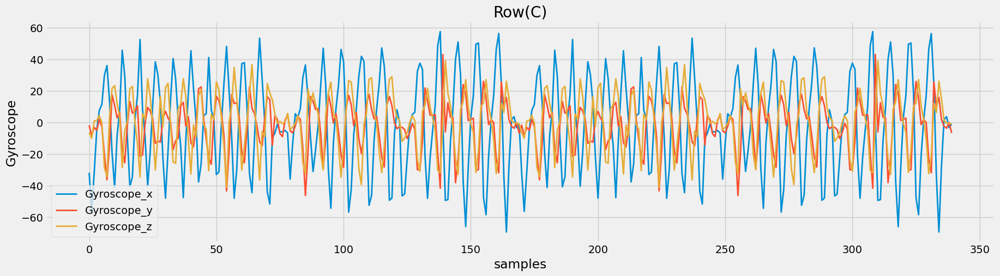

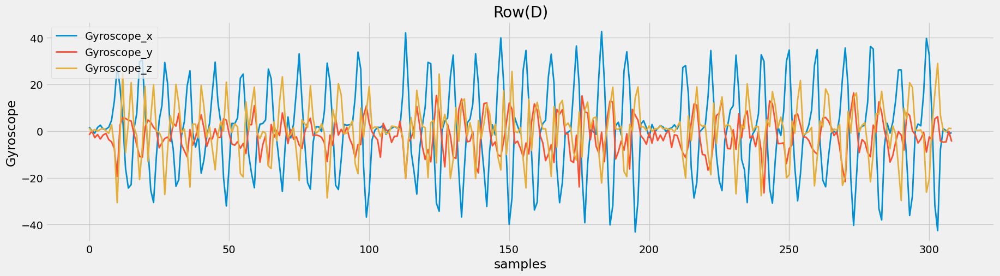

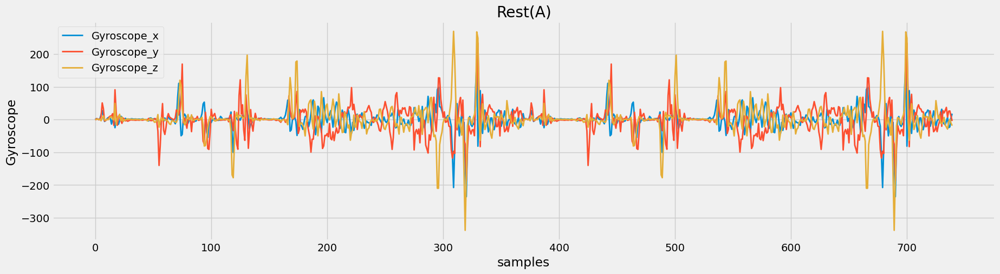

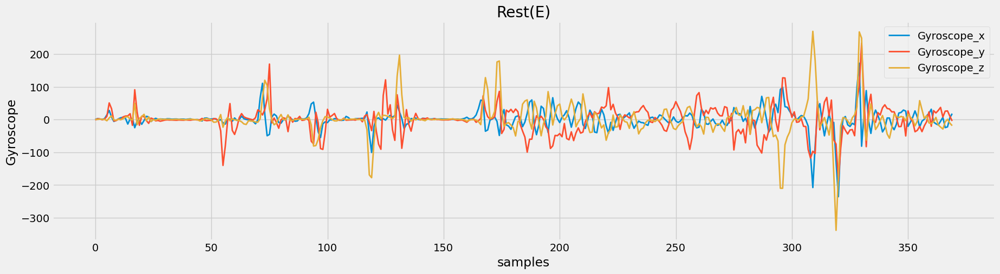

In [13]:
labels=df["Label"].unique()
participants=df["Participants"].unique()

for label in labels:
    for participant in participants:
        all_axis_df=df.query(f"Label=='{label}'").query(f"Participants=='{participant}'").reset_index()


        if len(all_axis_df)!=0:
            fig,ax=plt.subplots()
            all_axis_df[["Gyroscope_x","Gyroscope_y","Gyroscope_z"]].plot(ax=ax)
            ax.set_ylabel("Gyroscope")
            ax.set_xlabel("samples")
            plt.title(f"{label}({participant})".title())
            plt.legend()

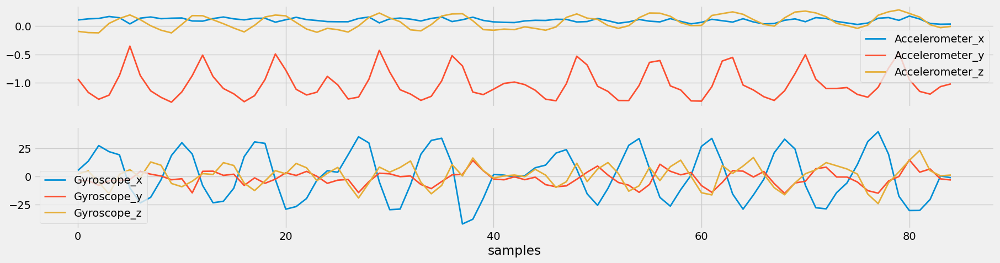

In [14]:

label="row"
participants="A"
Comb_df=df.query(f"Label=='{label}'").query(f"Participants=='{participants}'").reset_index(drop=True)

fig,ax=plt.subplots(nrows=2,sharex=True)
Comb_df[["Accelerometer_x","Accelerometer_y","Accelerometer_z"]].plot(ax=ax[0])
Comb_df[["Gyroscope_x","Gyroscope_y","Gyroscope_z"]].plot(ax=ax[1])
ax[1].set_xlabel("samples")
ax[0].legend()
ax[1].legend()

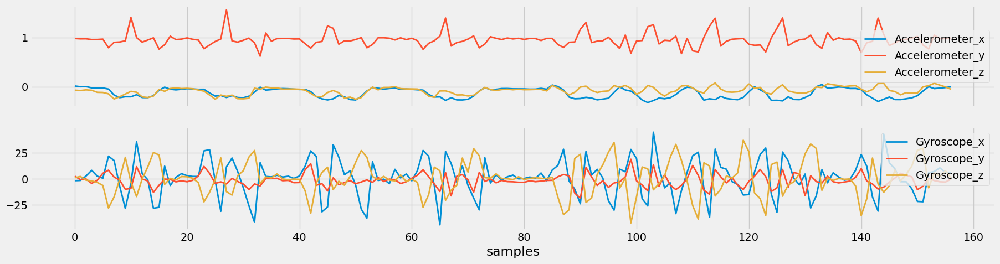

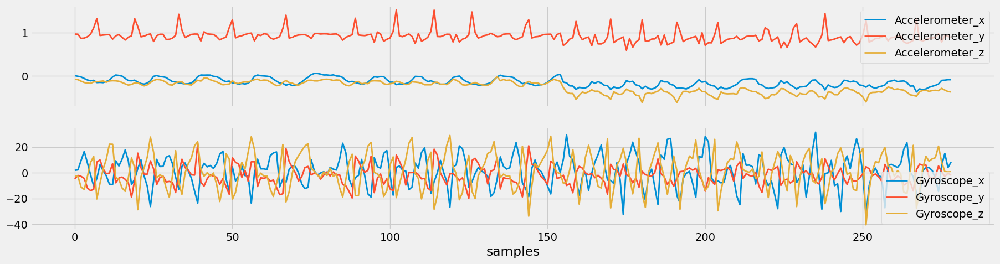

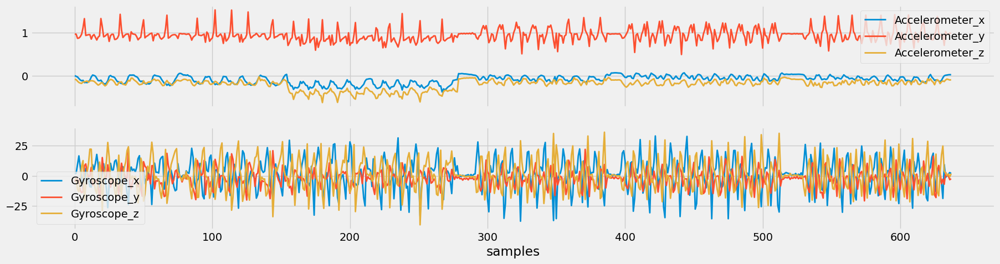

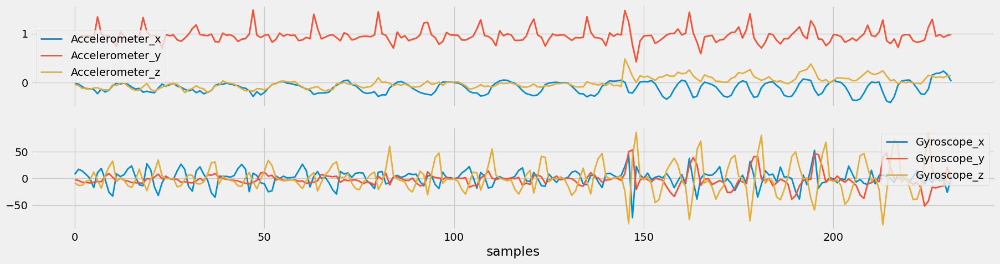

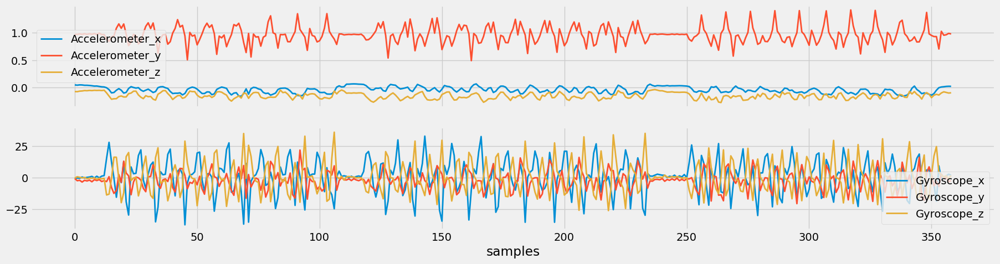

...

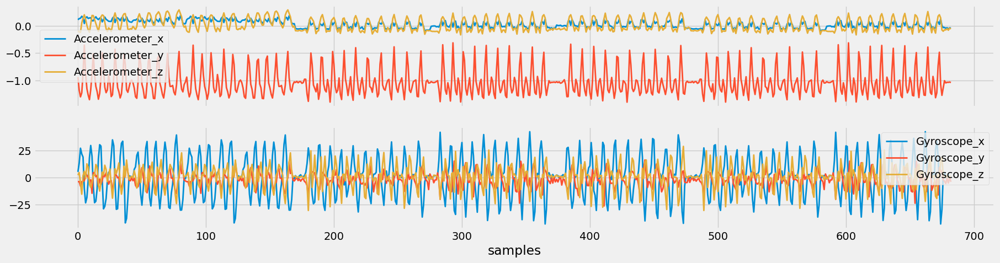

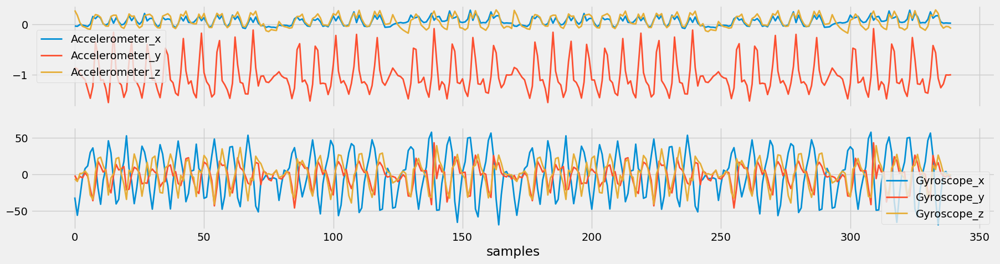

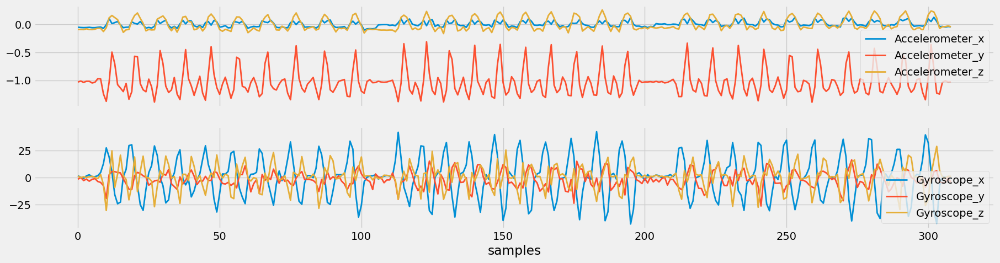

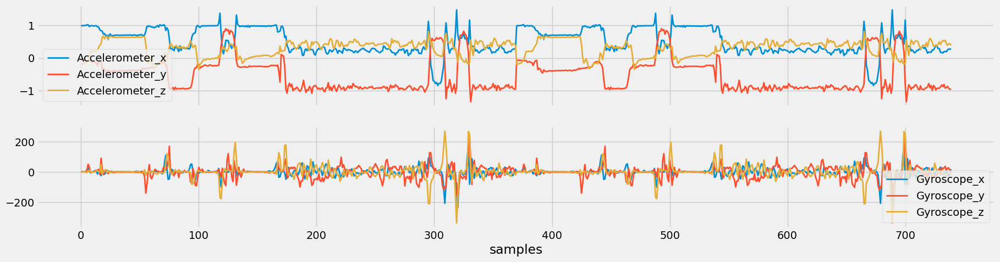

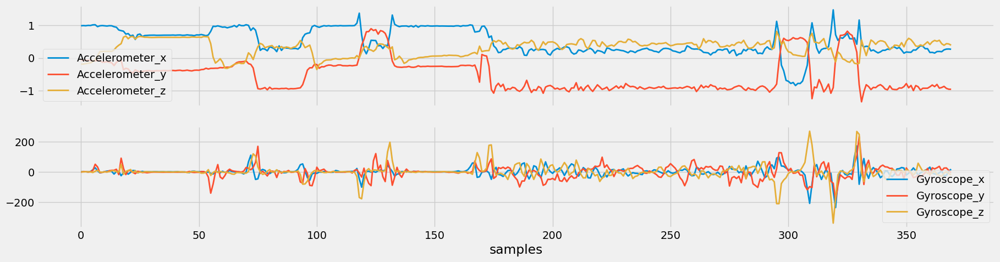

In [15]:
labels=df["Label"].unique()
participants=df["Participants"].unique()

for label in labels:
    for participant in participants:
        com_plot_df=df.query(f"Label=='{label}'").query(f"Participants=='{participant}'").reset_index()


        if len(com_plot_df)!=0:

            fig,ax=plt.subplots(nrows=2,sharex=True)
            com_plot_df[["Accelerometer_x","Accelerometer_y","Accelerometer_z"]].plot(ax=ax[0])
            com_plot_df[["Gyroscope_x","Gyroscope_y","Gyroscope_z"]].plot(ax=ax[1])
            ax[1].set_xlabel("samples")
            ax[0].legend()
            ax[1].legend()    
            plt.savefig(f"/home/ai/Documents/FitnessTracker/reports/figures/{label.title()}({participant}).png")
            plt.show()